In [1]:
print("==========================================")
current_date_time <- format(Sys.time(), "%Y-%m-%d %H:%M:%S")
sprintf("[TIMESTAMP] %s", current_date_time)
print("==========================================")

[1] "=========================================="


[1] "[TIMESTAMP] 2023-09-25 15:42:18"

[1] "=========================================="


# (How to) Perform guide clustering on real ileum data (post processing with cellranger aggr)

- (link followed) https://satijalab.org/seurat/articles/pbmc3k_tutorial.html

## Install and load packages required in R

In [2]:
# install packages
print("  begin -- installing R packages")

options(install.packages.compile.from.source = "always")
# options(pkgType="binary")

install.packages("dplyr", repos = getCRANmirrors()[1,"URL"])
install.packages("patchwork", repos = getCRANmirrors()[1,"URL"])


install.packages("Seurat", repos = getCRANmirrors()[1,"URL"])


print("  done  -- installing R packages")

[1] "  begin -- installing R packages"


Installing package into ‘/home/richardvan/R/x86_64-pc-linux-gnu-library/4.3’
(as ‘lib’ is unspecified)

Installing package into ‘/home/richardvan/R/x86_64-pc-linux-gnu-library/4.3’
(as ‘lib’ is unspecified)

Installing package into ‘/home/richardvan/R/x86_64-pc-linux-gnu-library/4.3’
(as ‘lib’ is unspecified)



[1] "  done  -- installing R packages"


In [3]:
# load packages
print("  begin -- loading packages")

library(dplyr)                  # a powerful and user-friendly package for data manipulation and transformation, 
                                #   providing a consistent and intuitive grammar to efficiently perform common data 
                                #   tasks on data frames and tibbles.  
library(patchwork)              # designed to make plot composition in R extremely simple and powerful. It is mainly 
                                #   intended for users of ggplot2 and goes to great lengths to make sure ggplots are 
                                #   properly aligned no matter the complexity of your composition.
library(Seurat)                 # designed for the analysis of single-cell RNA sequencing (scRNA-seq) data, offering 
                                #   a comprehensive toolkit for preprocessing, clustering, and visualizing individual 
                                #   cell gene expression profiles.

print("  done  -- loading packages")

[1] "  begin -- loading packages"



Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


The legacy packages maptools, rgdal, and rgeos, underpinning the sp package,
which was just loaded, will retire in October 2023.
Please refer to R-spatial evolution reports for details, especially
https://r-spatial.org/r/2023/05/15/evolution4.html.
It may be desirable to make the sf package available;
package maintainers should consider adding sf to Suggests:.
The sp package is now running under evolution status 2
     (status 2 uses the sf package in place of rgdal)

Attaching SeuratObject



[1] "  done  -- loading packages"


### Load the data

In [4]:
# Load the ileum dataset that was the output of cellranger aggr
ileum.data <- Read10X(data.dir = "data/realdata_forSeurat/10x_ileum/filtered_feature_bc_matrix/")


In [5]:
# Initialize the Seurat object with the raw (non-normalized data).
ileum <- CreateSeuratObject(counts = ileum.data, project = "10x_ileum", min.cells = 3, min.features = 200)
ileum

An object of class Seurat 
22309 features across 29710 samples within 1 assay 
Active assay: RNA (22309 features, 0 variable features)

### Analyzing the count matrix

In [6]:
# Lets examine a few genes in the first thirty cells
#   (about output) The . values in the matrix represent 0s (no molecules detected). Since most values in an scRNA-seq 
#     matrix are 0, Seurat uses a sparse-matrix representation whenever possible. This results in significant memory 
#     and speed savings for Drop-seq/inDrop/10x data.
ileum.data[c("Smoc2", "Lgr5", "Tiam1"), 1:30]

  [[ suppressing 30 column names ‘AAACCCAAGACTTCGT-1’, ‘AAACCCAAGGCGATAC-1’, ‘AAACGAACAGTCGGTC-1’ ... ]]



3 x 30 sparse Matrix of class "dgCMatrix"
                                                                   
Smoc2 . . . . . . . . . . . . . . . . 2  .  . . . . . . . 1 . . . .
Lgr5  . . . 1 . . . . . . . . 3 . . . 4 11 12 2 . . . . . . . . . .
Tiam1 . . . . . 1 . . . . . . . . . . 2  .  . 1 . . . . . . . . . .

In [7]:
# looking at dense vs sparse size
dense.size <- object.size(as.matrix(ileum.data))
dense.size

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 6.9 GiB”


7385317768 bytes

In [8]:
sparse.size <- object.size(ileum.data)
sparse.size

487165592 bytes

In [9]:
dense.size/sparse.size

15.2 bytes

## Standard pre-processing workflow
- selection of cells based on QC metrics
- filtration of cells based on QC metrics
- data normalization
- detection of highly variable features
- scaling of the data
- Perform linear dimensional reduction
- Determine the ‘dimensionality’ of the dataset

### Selection of cells based on QC metrics
- (QC metrics commonly used)
- The number of unique genes detected in each cell.
    * Low-quality cells or empty droplets will often have very few genes
    * Cell doublets or multiplets may exhibit an aberrantly high gene count
- Similarly, the total number of molecules detected within a cell (correlates strongly with unique genes)
- The percentage of reads that map to the mitochondrial genome
    * Low-quality / dying cells often exhibit extensive mitochondrial contamination
    * We calculate mitochondrial QC metrics with the PercentageFeatureSet() function, which calculates the percentage of counts originating from a set of features
    * We use the set of all genes starting with MT- as a set of mitochondrial genes

In [10]:
# The [[ operator can add columns to object metadata. This is a great place to stash QC stats
ileum[["percent.mt"]] <- PercentageFeatureSet(ileum, pattern = "^MT-")

In [11]:
# Show QC metrics for the first 5 cells
#   (note) the number of unique genes and total molecules are automatically calcualted during CreateSeuratObject()
head(ileum@meta.data, 5)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt
,<fct>,<dbl>,<int>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,0


### Filtration of cells based on QC metrics after visualization

Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of percent.mt.”


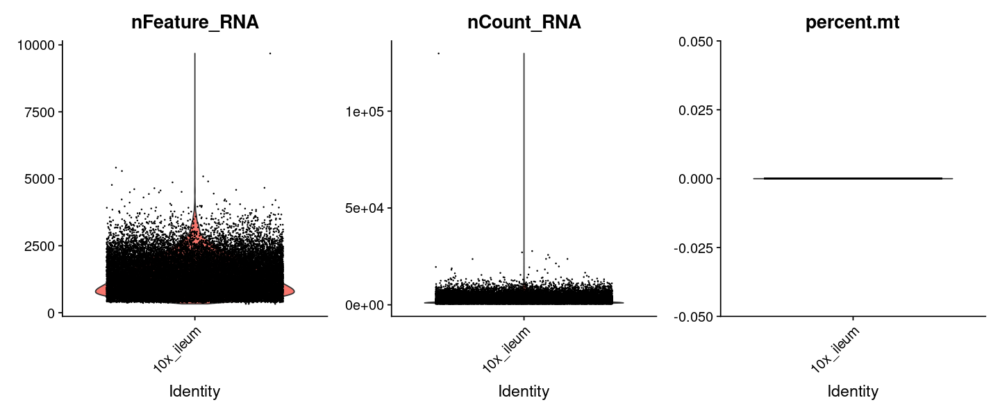

In [12]:
# Visualize QC metrics as a violin plot
options(repr.plot.height = 5, repr.plot.width = 12)
VlnPlot(ileum, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3)

Warning message in cor(x = data[, 1], y = data[, 2]):
“the standard deviation is zero”


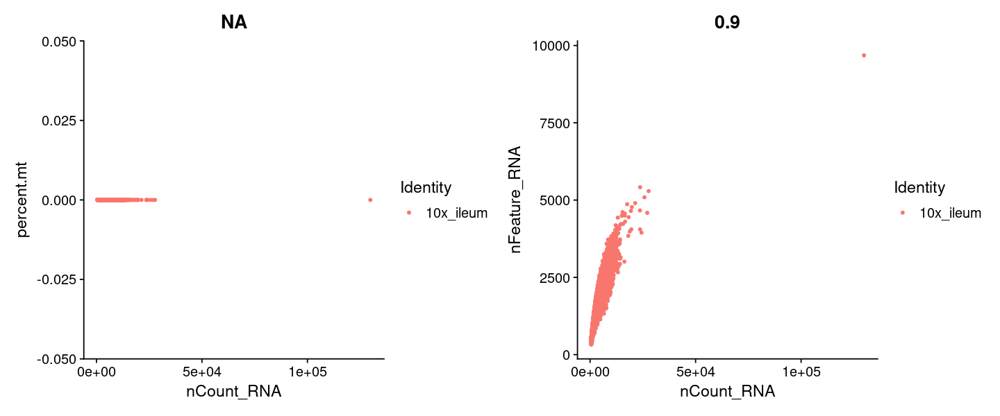

In [13]:
# FeatureScatter is typically used to visualize feature-feature relationships, but can be used
# for anything calculated by the object, i.e. columns in object metadata, PC scores etc.
plot1 <- FeatureScatter(ileum, feature1 = "nCount_RNA", feature2 = "percent.mt")
plot2 <- FeatureScatter(ileum, feature1 = "nCount_RNA", feature2 = "nFeature_RNA")
plot1 + plot2

In [14]:
# preview 'ileum' before
dim(ileum.data)
head(ileum.data, 5)

[1] 31053 29710

  [[ suppressing 34 column names ‘AAACCCAAGACTTCGT-1’, ‘AAACCCAAGGCGATAC-1’, ‘AAACGAACAGTCGGTC-1’ ... ]]



5 x 29710 sparse Matrix of class "dgCMatrix"
                                                                           
Xkr4    . . . . . . . 3 . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm1992  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm37381 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Rp1     . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Sox17   . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
              
Xkr4    ......
Gm1992  ......
Gm37381 ......
Rp1     ......
Sox17   ......

 .....suppressing 29676 columns in show(); maybe adjust 'options(max.print= *, width = *)'
 ..............................

In [15]:
# the actual call to filter
# - We filter cells that have unique feature counts over 2,500 or less than 200
# - We filter cells that have >5% mitochondrial counts

ileum <- subset(ileum, subset = nFeature_RNA > 200 & nFeature_RNA < 5000 & percent.mt < 5)

In [18]:
# preview 'ileum' after
dim(ileum.data)
head(ileum.data, 5)

[1] 31053 29710

  [[ suppressing 34 column names ‘AAACCCAAGACTTCGT-1’, ‘AAACCCAAGGCGATAC-1’, ‘AAACGAACAGTCGGTC-1’ ... ]]



5 x 29710 sparse Matrix of class "dgCMatrix"
                                                                           
Xkr4    . . . . . . . 3 . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm1992  . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Gm37381 . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Rp1     . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
Sox17   . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . . .
              
Xkr4    ......
Gm1992  ......
Gm37381 ......
Rp1     ......
Sox17   ......

 .....suppressing 29676 columns in show(); maybe adjust 'options(max.print= *, width = *)'
 ..............................

Warning message in SingleExIPlot(type = type, data = data[, x, drop = FALSE], idents = idents, :
“All cells have the same value of percent.mt.”


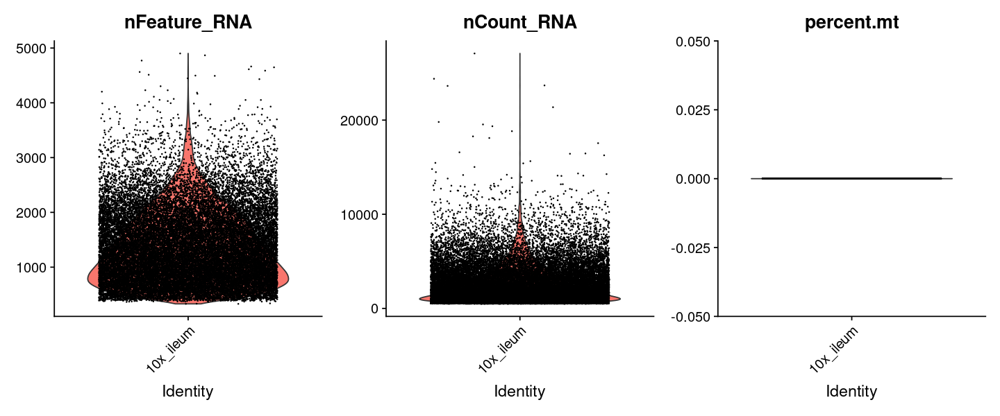

In [19]:
# Visualize QC metrics as a violin plot
options(repr.plot.height = 5, repr.plot.width = 12)
VlnPlot(ileum, features = c("nFeature_RNA", "nCount_RNA", "percent.mt"), ncol = 3)

Warning message in cor(x = data[, 1], y = data[, 2]):
“the standard deviation is zero”


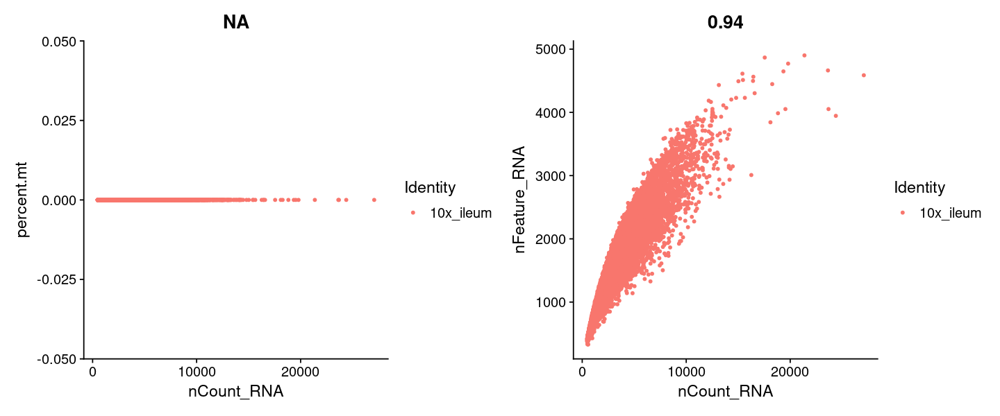

In [20]:
# FeatureScatter is typically used to visualize feature-feature relationships, but can be used
# for anything calculated by the object, i.e. columns in object metadata, PC scores etc.
plot1 <- FeatureScatter(ileum, feature1 = "nCount_RNA", feature2 = "percent.mt")
plot2 <- FeatureScatter(ileum, feature1 = "nCount_RNA", feature2 = "nFeature_RNA")
plot1 + plot2

### Data normalization
- By default, we employ a global-scaling normalization method “LogNormalize” that normalizes the feature expression measurements for each cell by the total expression, multiplies this by a scale factor (10,000 by default), and log-transforms the result. Normalized values are stored in pbmc[["RNA"]]@data.

In [21]:
# preview 'ileum' before
head(ileum, 5)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt
,<fct>,<dbl>,<int>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,0


In [22]:
ileum <- NormalizeData(ileum, normalization.method = "LogNormalize", scale.factor = 10000)

In [23]:
# preview 'ileum' after
head(ileum, 5)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt
,<fct>,<dbl>,<int>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,0


### Identification of highly variable features (feature selection)
- We next calculate a subset of features that exhibit high cell-to-cell variation in the dataset 
    * (i.e, they are highly expressed in some cells, and lowly expressed in others). 
- **We and others have found that focusing on these genes in downstream analysis helps to highlight biological signal in single-cell datasets.**
- Our procedure in Seurat is described in detail here, and improves on previous versions by directly modeling the mean-variance relationship inherent in single-cell data, and is implemented in the FindVariableFeatures() function. 
- By default, we return 2,000 features per dataset. These will be used in downstream analysis, like PCA.

In [24]:
# preview 'ileum' before
dim(ileum)
head(ileum, 5)

[1] 22309 29706

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt
,<fct>,<dbl>,<int>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,0


In [25]:
ileum <- FindVariableFeatures(ileum, selection.method = "vst", nfeatures = 2000)

In [26]:
# preview 'ileum' after
dim(ileum)
head(ileum, 5)

[1] 22309 29706

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt
,<fct>,<dbl>,<int>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,0


In [27]:
# Identify the 10 most highly variable genes
top10 <- head(VariableFeatures(ileum), 10)
top10

[1] "Csmd1"   "Kcnb2"   "Dgkb"    "Prkg1"   "Cacnb2"  "Fam155a" "Myh11"  
 [8] "Chrm2"   "Nrxn1"   "Pcdh15"

When using repel, set xnudge and ynudge to 0 for optimal results



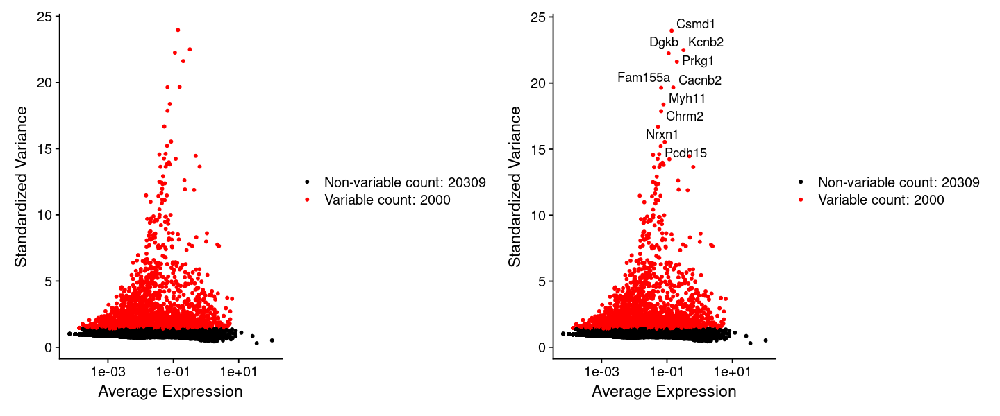

In [28]:
# plot variable features with and without labels
plot1 <- VariableFeaturePlot(ileum)
plot2 <- LabelPoints(plot = plot1, points = top10, repel = TRUE)
plot1 + plot2

### Scaling the data
- The ScaleData() function:
    * Shifts the expression of each gene, so that the mean expression across cells is 0
    * Scales the expression of each gene, so that the variance across cells is 1
        + This step gives equal weight in downstream analyses, so that highly-expressed genes do not dominate
    * The results of this are stored in pbmc[["RNA"]]@scale.data

In [29]:
# preview 'pbmc' before
dim(ileum)
head(ileum, 5)

[1] 22309 29706

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt
,<fct>,<dbl>,<int>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,0


In [30]:
# Performing the scaling step (takes awhile ~____ mins)
all.genes <- rownames(ileum)
ileum <- ScaleData(ileum, features = all.genes)

Centering and scaling data matrix



In [31]:
# preview 'pbmc' after
dim(ileum)
head(ileum, 5)

[1] 22309 29706

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt
,<fct>,<dbl>,<int>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,0


### Perform linear dimensional reduction (PCA) on the scaled data
- By default, only the previously determined variable features are used as input, but can be defined using features argument if you wish to choose a different subset.

In [32]:
# the actual PCA call
ileum <- RunPCA(ileum, features = VariableFeatures(object = ileum))

PC_ 1 
Positive:  Zdhhc14, Plcb1, Kcnma1, Chrm3, 5330417C22Rik, Cracr2a, Ptprn2, Fry, Arhgap24, Ccnd3 
	   Gm609, Slc12a8, Car8, Ica1, Sytl2, Tnfaip8, Nav2, Spink4, Slc12a2, Sidt1 
	   Muc2, Sntb1, Galnt7, Arhgef38, 2610035D17Rik, Naaladl2, Tanc2, Inpp4b, Klf12, Hepacam2 
Negative:  Ace2, Cubn, Aspa, Maf, Slc15a1, Slc5a1, Abcc2, Abcb1a, Slc13a1, Sema6a 
	   2010106E10Rik, Pls1, Gramd1b, Cyp3a13, Dpp4, Slc13a2, Clec2e, Slc10a2, Enpep, Cobl 
	   Mertk, Sis, Apob, Vil1, Anpep, Ceacam20, Gda, Mep1b, Nlrp9b, Slc6a19 
PC_ 2 
Positive:  Plcb1, Ptprn2, 5330417C22Rik, Sytl2, Chrm3, Slc12a8, Kcnma1, Shroom3, Hepacam2, Ica1 
	   Cracr2a, Gm609, Car8, Srgap1, Galnt7, Muc2, Spink4, Rab27b, Bcas1, Fut8 
	   Tanc2, Agr2, Myrip, 9030622O22Rik, Mcf2l, Arfgef3, Arhgef38, Fam189a1, Naaladl2, Asph 
Negative:  Arhgap15, Dock2, Ptprc, Aff3, Prkcb, Ebf1, Gm26740, Bank1, Dock10, Ikzf3 
	   Ikzf1, Fli1, Pax5, Mef2c, Ripor2, Inpp5d, St6galnac3, Wdfy4, Sh3kbp1, Akt3 
	   March1, Btla, Pip4k2a, Zeb1, Kcnq5, Ppp1r

In [33]:
# preview 'pbmc' after
dim(ileum)
head(ileum, 5)

[1] 22309 29706

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt
,<fct>,<dbl>,<int>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,0


In [34]:
# Examine and visualize PCA results a few different ways
print(ileum[["pca"]], dims = 1:5, nfeatures = 5)

PC_ 1 
Positive:  Zdhhc14, Plcb1, Kcnma1, Chrm3, 5330417C22Rik 
Negative:  Ace2, Cubn, Aspa, Maf, Slc15a1 
PC_ 2 
Positive:  Plcb1, Ptprn2, 5330417C22Rik, Sytl2, Chrm3 
Negative:  Arhgap15, Dock2, Ptprc, Aff3, Prkcb 
PC_ 3 
Positive:  Prkg1, 9530026P05Rik, Meis2, Pcdh7, Dlc1 
Negative:  Bank1, Ebf1, Pax5, Dock2, Arhgap15 
PC_ 4 
Positive:  Inpp4b, Ptprr, Bach2, Arhgap15, Dock2 
Negative:  Kcnq1, Cftr, Sema5a, Cps1, Pde8b 
PC_ 5 
Positive:  Samd5, Itln1, Lyz1, Mmp7, Defa24 
Negative:  Fcgbp, Fer1l6, Clca1, Frmd3, Zg16 


#### Seurat provides several useful ways of visualizing both cells and features that define the PCA
- VizDimReduction()
- DimPlot()
- DimHeatmap()
    * In particular DimHeatmap() allows for easy exploration of the primary sources of heterogeneity in a dataset, and can be useful when trying to decide which PCs to include for further downstream analyses. 
    * Both cells and features are ordered according to their PCA scores. 
    * Setting cells to a number plots the ‘extreme’ cells on both ends of the spectrum, which dramatically speeds plotting for large datasets. 
    * Though clearly a supervised analysis, we find this to be a valuable tool for exploring correlated feature sets.

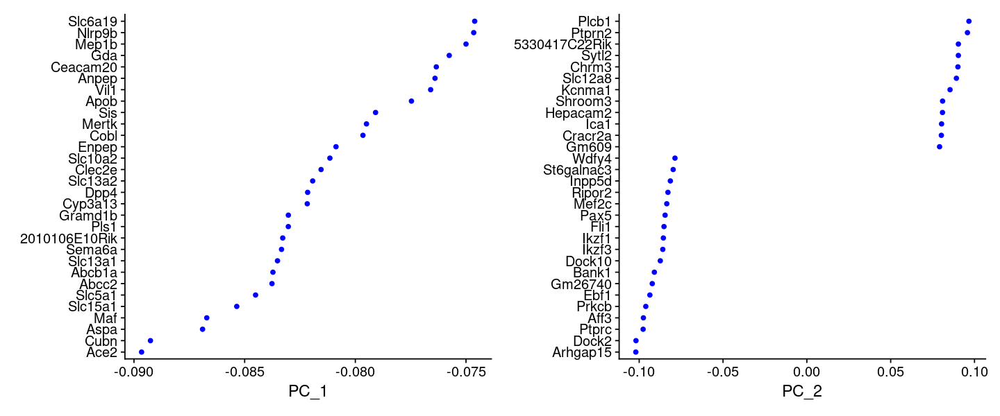

In [35]:
VizDimLoadings(ileum, dims = 1:2, reduction = "pca")

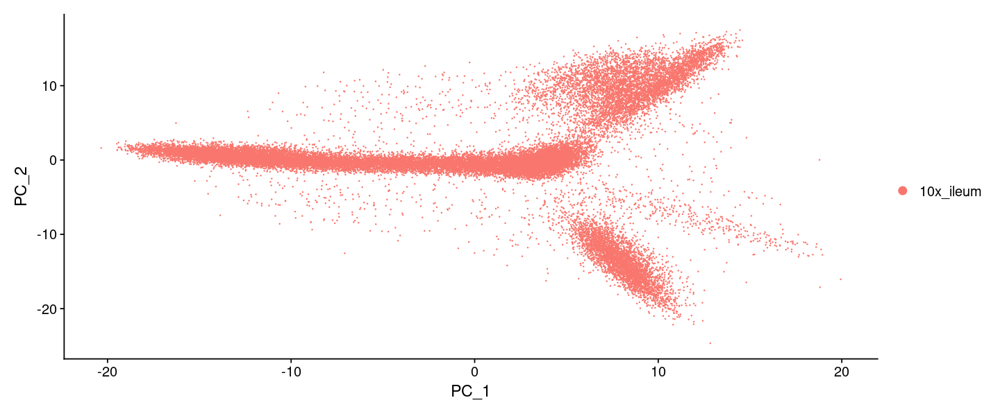

In [36]:
DimPlot(ileum, reduction = "pca")

In [ ]:
# heatmap of the first PC
# Specify plot sizes to be increased for plots made by Seurat functions
options(repr.plot.height = 12, repr.plot.width = 12)
DimHeatmap(ileum, dims = 1, cells = 500, balanced = TRUE)

In [ ]:
# heatmap of 15 PCs
options(repr.plot.height = 18, repr.plot.width = 12)
DimHeatmap(ileum, dims = 1:15, cells = 500, balanced = TRUE)

### Determine the ‘dimensionality’ of the dataset
- To overcome the extensive technical noise in any single feature for scRNA-seq data, Seurat clusters cells based on their PCA scores, with each PC essentially representing a ‘metafeature’ that combines information across a correlated feature set. 
- The top principal components therefore represent a robust compression of the dataset. 
- However, how many components should we choose to include? 10? 20? 100?

In [39]:
# The JackStrawPlot() function 
#   (provides) a visualization tool for comparing the distribution of p-values for each PC with a uniform 
#     distribution (dashed line). ‘Significant’ PCs will show a strong enrichment of features with 
#     low p-values (solid curve above the dashed line). 
#     In this case it appears that there is a sharp drop-off in significance after the first 10-12 PCs.

# preview 'pbmc' before
head(ileum, 5)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt
,<fct>,<dbl>,<int>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,0


In [40]:
# NOTE: This process can take a long time for big datasets (~15 min for uleum data), comment out for expediency. More
# approximate techniques such as those implemented in ElbowPlot() can be used to reduce
# computation time
ileum <- JackStraw(ileum, num.replicate = 100)

In [41]:
# preview 'pbmc' after JackStraw() call and before ScoreJackStraw() call
head(ileum, 5)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt
,<fct>,<dbl>,<int>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,0


In [42]:
ileum <- ScoreJackStraw(ileum, dims = 1:10)

ERROR: Error in pAll[, dims, drop = FALSE]: subscript out of bounds


In [43]:
# preview 'pbmc' after
head(ileum, 5)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt
,<fct>,<dbl>,<int>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,0


In [ ]:
options(repr.plot.height = 12, repr.plot.width = 12)
JackStrawPlot(ileum, dims = 1:10)

In [44]:
# The ElbowPlot() function 
#   (provides) An alternative heuristic method generates a ranking of principle components based on the percentage 
#     of variance explained by each one (ElbowPlot() function). In this example, we can observe an ‘elbow’ 
#     around PC9-10, suggesting that the majority of true signal is captured in the first 10 PCs.

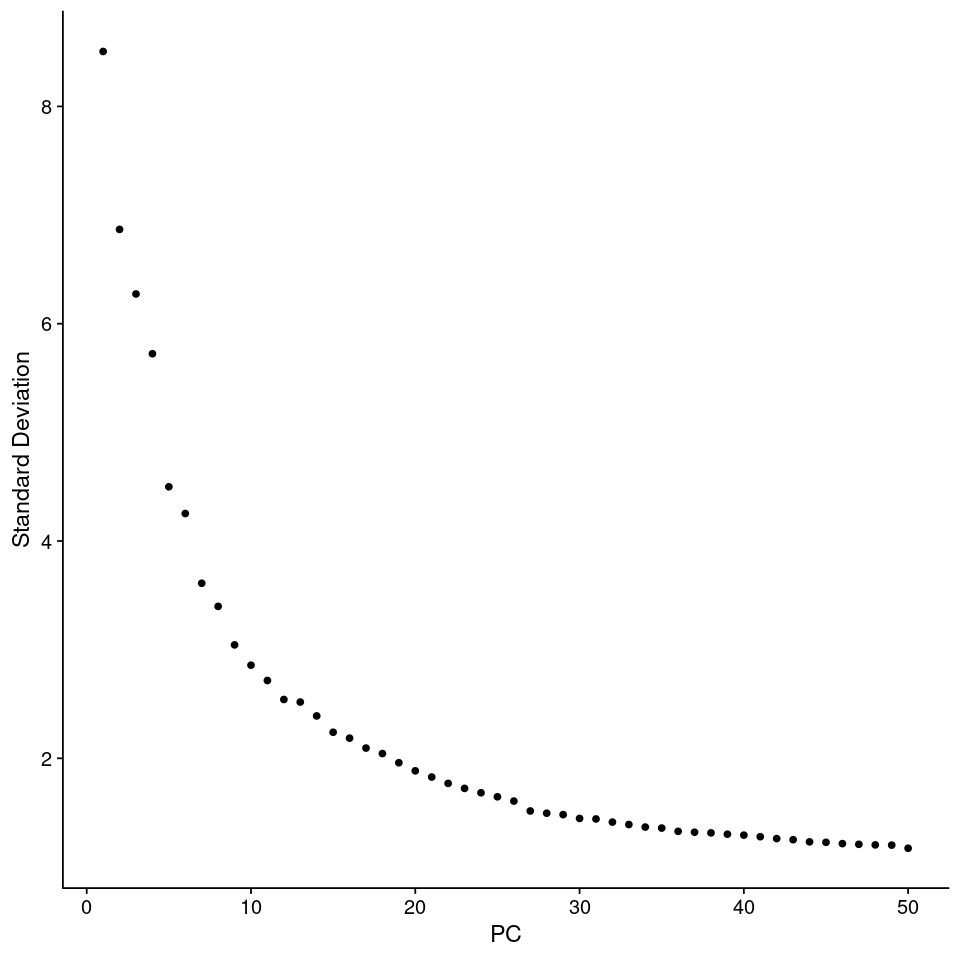

In [192]:
options(repr.plot.height = 8, repr.plot.width = 8)
ElbowPlot(ileum, ndims=50)

## Cluster the cells
- the FindNeighbors() function
    * takes as input the previously defined dimensionality of the dataset (first 10 PCs).
    * we first construct a KNN graph based on the euclidean distance in PCA space, and refine the edge weights between any two cells based on the shared overlap in their local neighborhoods (Jaccard similarity)
- the FindClusters() function
    * we next apply modularity optimization techniques such as the Louvain algorithm (default) or SLM to iteratively group cells together, with the goal of optimizing the standard modularity function
    * contains a resolution parameter that sets the ‘granularity’ of the downstream clustering, with increased values leading to a greater number of clusters.
        + We find that setting this parameter between 0.4-1.2 typically returns good results for single-cell datasets of around 3K cells.
        + Optimal resolution often increases for larger datasets.
    * The clusters can be found using the Idents() function.

In [46]:
# preview 'pbmc' before
head(ileum, 5)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt
,<fct>,<dbl>,<int>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,0


In [47]:
ileum <- FindNeighbors(ileum, dims = 1:30)

Computing nearest neighbor graph

Computing SNN



In [48]:
# preview 'pbmc' after FindNeighbors() and before FindClusters()
head(ileum, 5)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt
,<fct>,<dbl>,<int>,<dbl>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,0
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,0
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,0


In [180]:
ileum <- FindClusters(ileum, resolution = 0.1)            ## CHANGE THE RESOLUTION TO INFLUENCE # OF CLUSTERS FOUND

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 29706
Number of edges: 1215072

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9696
Number of communities: 11
Elapsed time: 7 seconds


In [54]:
# preview 'pbmc' after
head(ileum, 5)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,RNA_snn_res.0.3,seurat_clusters,RNA_snn_res.0.2,RNA_snn_res.0.1
,<fct>,<dbl>,<int>,<dbl>,<fct>,<fct>,<fct>,<fct>
AAACCCAAGACTTCGT-1,10x_ileum,1987,1237,0,1,0,2,0
AAACCCAAGGCGATAC-1,10x_ileum,4086,1894,0,6,3,5,3
AAACGAACAGTCGGTC-1,10x_ileum,1165,811,0,2,2,3,2
AAACGAAGTAGGCAAC-1,10x_ileum,529,438,0,0,0,0,0
AAACGAAGTCGACTTA-1,10x_ileum,3405,1751,0,6,3,5,3


In [55]:
# Look at cluster IDs of the first 5 cells
head(Idents(ileum), 5)

AAACCCAAGACTTCGT-1 AAACCCAAGGCGATAC-1 AAACGAACAGTCGGTC-1 AAACGAAGTAGGCAAC-1 
                 0                  3                  2                  0 
AAACGAAGTCGACTTA-1 
                 3 
Levels: 0 1 2 3 4 5 6 7 8 9 10

## Run non-linear dimensional reduction (UMAP/tSNE)
- Seurat offers several non-linear dimensional reduction techniques, such as tSNE and UMAP, to visualize and explore these datasets. 
- The goal of these algorithms is to learn the underlying manifold of the data in order to place similar cells together in low-dimensional space. 
- Cells within the graph-based clusters determined above should co-localize on these dimension reduction plots. 
- As input to the UMAP and tSNE, we suggest using the same PCs as input to the clustering analysis.

In [87]:
# If you haven't installed UMAP, you can do so via
reticulate::py_install(packages = 'umap-learn')

ERROR: Error: Tools for managing Python virtual environments are not installed.

Install venv with:
$ sudo apt-get install python3-venv




In [172]:
## If you haven't installed UMAP, you can do so via reticulate::py_install(packages = 'umap-learn')
ileum <- RunUMAP(ileum, dims = 1:10)

11:11:47 UMAP embedding parameters a = 0.9922 b = 1.112

11:11:47 Read 29706 rows and found 10 numeric columns

11:11:47 Using Annoy for neighbor search, n_neighbors = 30

11:11:47 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
|

11:11:54 Writing NN index file to temp file /tmp/Rtmp6EAYXF/file729fd748fb760

11:11:54 Searching Annoy index using 1 thread, search_k = 3000

11:12:05 Annoy recall = 100%

11:12:05 Commencing smooth kNN distance calibration using 1 thread
 with target n_neighbors = 30

11:12:07 Initializing from normalized Laplacian + noise (using irlba)

11:12:12 Commencing optimization for 200 epochs, with 1225304 positive edges

11:12:31 Optimization finished



### Preview the UMAP and TSNE plots

In [ ]:
# note that you can set `label = TRUE` or use the LabelClusters function to help label individual clusters
12345 -> saved.seed
set.seed(saved.seed)

RunTSNE(
  ileum,
  dims=1:10,
  seed.use = saved.seed
) -> ileum



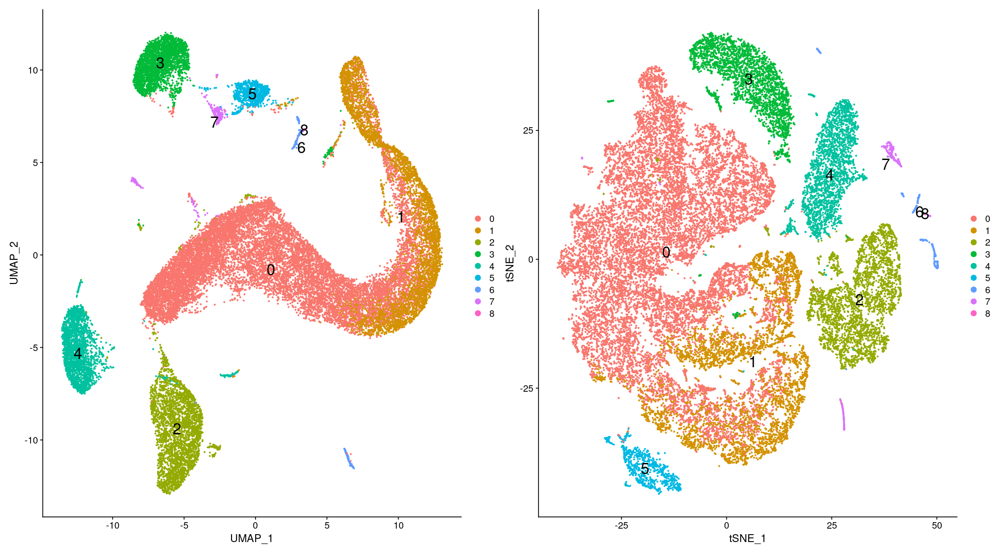

In [179]:
options(repr.plot.height = 10, repr.plot.width = 18)
umap_unlabeled <- DimPlot(ileum, reduction = "umap", label = TRUE, pt.size = 0.5, label.size = 7) 
tsne_unlabeled <- DimPlot(ileum, reduction = "tsne", label = TRUE, pt.size = 0.5, label.size = 7) 
umap_unlabeled + tsne_unlabeled

In [58]:
## save 
# saveRDS(ileum, file = "results/ileum_first_umap.rds")

## Finding differentially expressed features (cluster biomarkers)
- Seurat can help you find markers that define clusters via differential expression. 
- By default, it identifies positive and negative markers of a single cluster (specified in ident.1), compared to all other cells.

In [72]:
# The FindAllMarkers() function 
#   (provides) automates this process for all clusters
#     - can also test groups of clusters vs. each other, or against all cells.
#   (min.pct argument)
#     - requires a feature to be detected at a minimum percentage in either of the two groups of cells, and the 
#       thresh.test argument requires a feature to be differentially expressed (on average) by some amount between 
#       the two groups. 
#     - You can set both of these to 0, but with a dramatic increase in time - since this will test a large number 
#       of features that are unlikely to be highly discriminatory. 
#     - As another option to speed up these computations, max.cells.per.ident can be set. #
#     - This will downsample each identity class to have no more cells than whatever this is set to. 
#     - While there is generally going to be a loss in power, the speed increases can be significant and the most 
#       highly differentially expressed features will likely still rise to the top.

In [73]:
# (ex) find markers for every cluster compared to all remaining cells, report only the positive ones
ileum.markers <- FindAllMarkers(ileum, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25)
ileum.markers %>%
    group_by(cluster) %>%
    slice_max(n = 2, order_by = avg_log2FC)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10



p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
0.000000e+00,3.371332,0.838,0.172,0.000000e+00,0,Kcnq1
0.000000e+00,2.837977,0.475,0.053,0.000000e+00,0,Dmbt1
0.000000e+00,3.115382,0.586,0.134,0.000000e+00,1,Clca4a
0.000000e+00,2.409967,0.846,0.224,0.000000e+00,1,Slc10a2
0.000000e+00,5.297026,0.912,0.116,0.000000e+00,2,Fcgbp
0.000000e+00,4.530478,0.778,0.056,0.000000e+00,2,Clca1
0.000000e+00,2.461250,0.917,0.335,0.000000e+00,3,Slc13a1
0.000000e+00,1.969850,0.806,0.280,0.000000e+00,3,Rnf152
0.000000e+00,6.059160,0.977,0.037,0.000000e+00,4,Ebf1


In [60]:
# # (ex) find all markers of cluster 2
# cluster2.markers <- FindMarkers(ileum, ident.1 = 2, min.pct = 0.25)
# head(cluster2.markers, n = 5)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Xkr4,0,1.808069,0.385,0.062,0
2010300C02Rik,0,1.030000,0.480,0.180,0
Tbc1d8,0,1.025158,0.440,0.150,0
Fhl2,0,1.335672,0.497,0.150,0
Mfsd6,0,1.175768,0.527,0.215,0


In [61]:
# # (ex) find all markers distinguishing cluster 5 from clusters 0 and 3
# cluster5.markers <- FindMarkers(ileum, ident.1 = 5, ident.2 = c(0, 3), min.pct = 0.25)
# head(cluster5.markers, n = 5)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Mgat4a,0,-1.448350,0.372,0.741,0
Tbc1d8,0,1.295660,0.393,0.107,0
Myo1b,0,1.254562,0.406,0.110,0
Plcl1,0,1.872275,0.327,0.011,0
Spats2l,0,1.689021,0.390,0.035,0


In [62]:
# # (ex) find all markers distinguishing cluster 12 from clusters 14
# cluster12.markers <- FindMarkers(ileum, ident.1 = 12, ident.2 = 14, min.pct = 0.25)
# head(cluster12.markers, n = 5)

In [64]:
# Seurat has several tests for differential expression which can be set with the test.use parameter 
# For example, the ROC test returns the ‘classification power’ for any individual marker 
#   (ranging from 0 - random, to 1 - perfect).



In [65]:
# cluster0.markers <- FindMarkers(ileum, ident.1 = 0, logfc.threshold = 0.25, test.use = "roc", only.pos = TRUE)
# head(cluster0.markers, n = 5)

,myAUC,avg_diff,power,avg_log2FC,pct.1,pct.2
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
Kcnq1,0.886,2.3368291,0.772,3.371332,0.838,0.172
Cftr,0.833,1.6585850,0.666,2.392832,0.800,0.233
Camk1d,0.819,0.8009131,0.638,1.155473,0.970,0.874
Sema5a,0.796,1.5973781,0.592,2.304530,0.734,0.266
Taco1,0.780,1.0291440,0.560,1.484741,0.934,0.622


#### Seurat provides several useful ways of visualizing marker expression
- VlnPlot() - shows expression probability distributions across clusters
- FeaturePlot() - visualizes feature expression on a tSNE or PCA plot
- DoHeatmap() - generates an expression heatmap for given cells and features
- RidgePlot()
- CellScatter()
- DotPlot()

In [109]:
ileum.markers %>%
  group_by(cluster) %>%
    slice(1:2) %>%
      pull(gene) -> best.wilcox.gene.per.cluster

best.wilcox.gene.per.cluster

[1] "Kcnq1"   "Dmbt1"   "Clca4a"  "Slc10a2" "Fcgbp"   "Clca1"   "Slc13a1"
 [8] "Rnf152"  "Ebf1"    "Bank1"   "Lyz1"    "Itln1"   "Plb1"    "Slc5a12"
[15] "Skap1"   "Prkch"   "Kcnb2"   "Slc8a1"  "Prkg1"   "Cacnb2"  "Cdh19"  
[22] "Slc35f1"

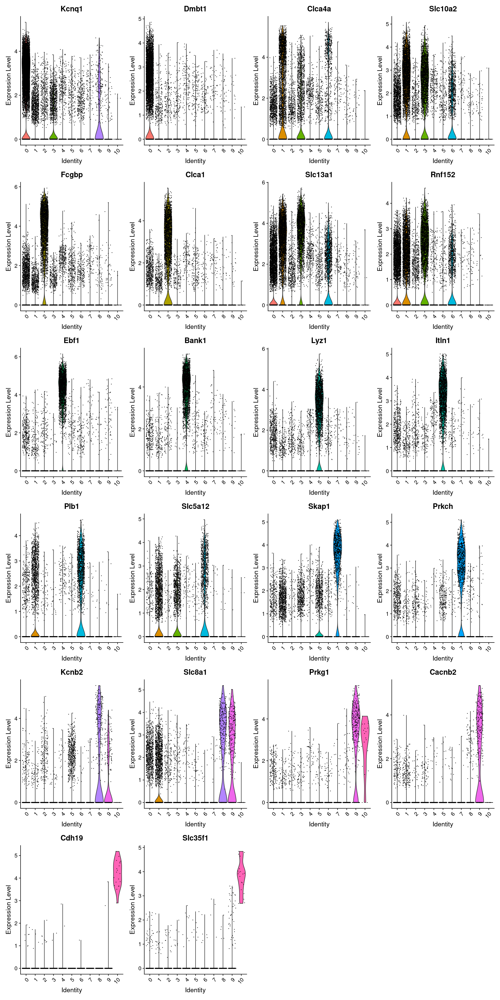

In [182]:
# looking top two DEGs per cluster 
options(repr.plot.height = 30, repr.plot.width = 15)
VlnPlot(ileum,features=best.wilcox.gene.per.cluster)

Warning message in FetchData.Seurat(object = object, vars = features, slot = slot):
“The following requested variables were not found: Defa6, Ta, Mk167, Best4, Ca7, Ca2”


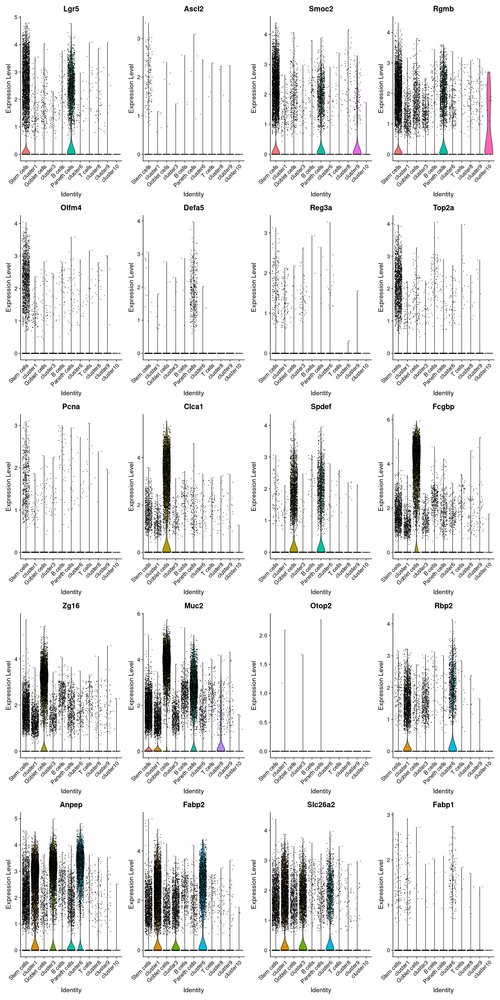

In [163]:
# Part 1 of 2
# (source) from Nature paper "Cells of the human intestinal tract mapped across space and time"
#  - (link) https://www.nature.com/articles/s41586-021-03852-1#Sec8
options(repr.plot.height = 30, repr.plot.width = 15)
VlnPlot(ileum,
                    features = c(
                                "Lgr5", "Ascl2", "Smoc2", "Rgmb", "Olfm4",    # Stem cells
                                "Defa5", "Defa6", "Reg3a",                    # Paneth
                                "Ta", "Mk167", "Top2a", "Pcna",               # Transit-amplifying
                                "Clca1", "Spdef", "Fcgbp", "Zg16", "Muc2",    # Goblet
                                "Best4", "Otop2", "Ca7",                       # BEST4 enterocyte
                                "Rbp2", "Anpep", "Fabp2",                     # enterocytes
                                "Ca2", "Slc26a2", "Fabp1"                    # colonocytes
                             ))

Warning message in FetchData.Seurat(object = object, vars = features, slot = slot):
“The following requested variables were not found: Neurod1, Irag2, Klk15, Klk3, Mln, Ins, Npw”


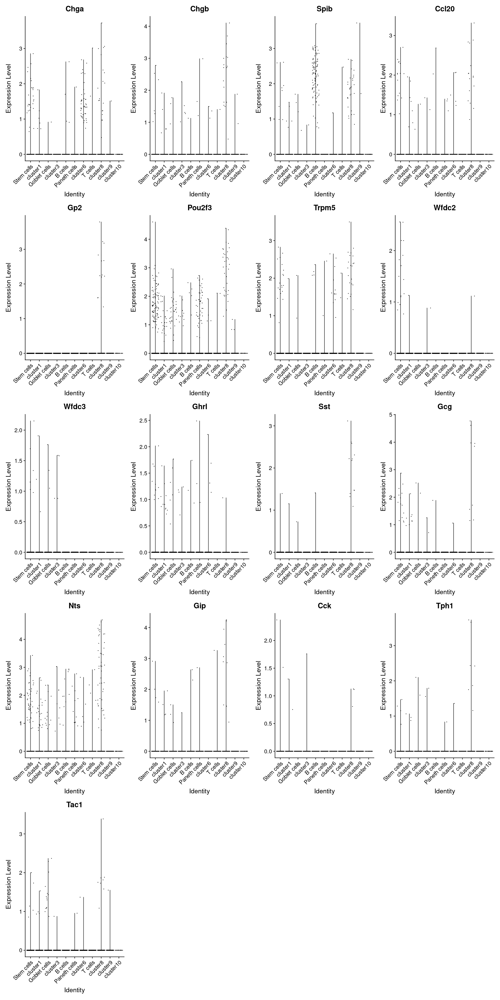

In [164]:
# Part 2 of 2
# (source) from Nature paper "Cells of the human intestinal tract mapped across space and time"
#  - (link) https://www.nature.com/articles/s41586-021-03852-1#Sec8
options(repr.plot.height = 30, repr.plot.width = 15)
VlnPlot(ileum,
                    features = c(
                                "Chga", "Chgb", "Neurod1",                    # enteroendocrine
                                "Spib", "Ccl20", "Gp2",                       # Microfold cells
                                "Pou2f3", "Irag2", "Trpm5",                   # Tuft cells
                                "Klk15", "Klk3", "Wfdc2", "Wfdc3",            # BEST2 goblet cells
                        
                                "Mln", "Ghrl", "Sst", "Ins", "Gcg", "Nts",    # enteroendocrine cells
                                "Gip", "Cck", "Tph1", "Npw", "Tac1"           # enteroendocrine cells
                        
                             ))

Warning message in FetchData.Seurat(object = object, vars = features, slot = slot):
“The following requested variables were not found: Hba, Mt, Hmgb”


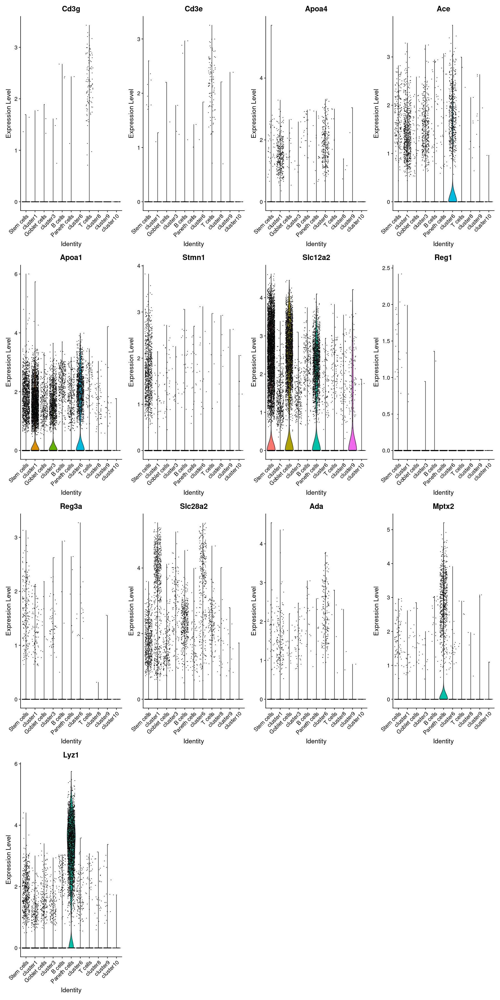

In [165]:
# Part 1 of 2
# (source) from 10X tutorial on intestinal data
#  - (linke) https://support.10xgenomics.com/img/single-cell-gex/gex-analysis-tour-4.png
options(repr.plot.height = 30, repr.plot.width = 15)
VlnPlot(ileum, features = c(
                                "Hba",                       # Erythrocytes/ Dying cells
                                # "Mt genes",                  # Dying cells 
                                "Cd3g", "Cd3e",              # Immune cells
                                "Apoa4", "Mt",               # Enterocytes/ Dying cells
                                "Ace","Apoa1",               # Enterocytes
                                "Stmn1", "Hmgb", "Slc12a2",  # CBCs (crypt base columnar cells)
                                "Reg1","Reg3a",              # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                "Mptx2", "Lyz1"             # Paneth cell  
                                # "Mt genes",                  # Dying cells
                          
                             ))

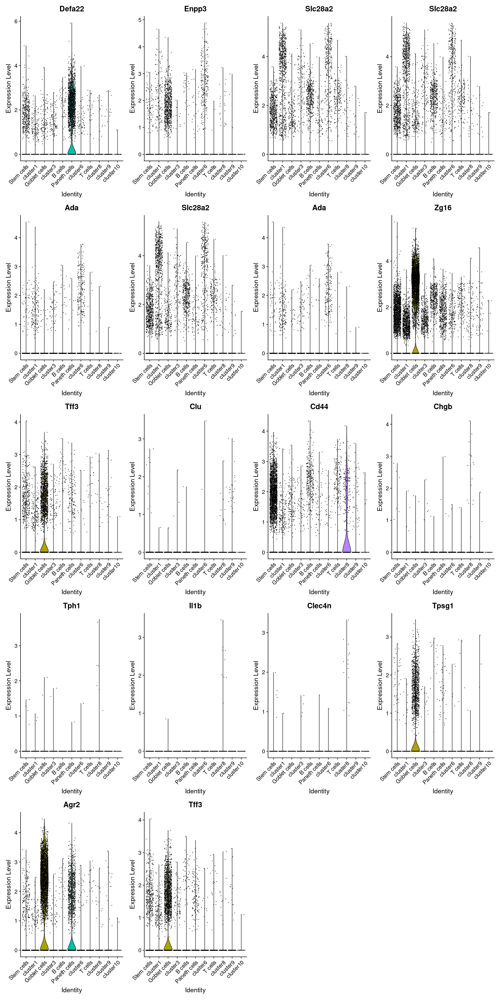

In [161]:
# Part 2 of 2
# (source) from 10X tutorial on intestinal data
#  - (linke) https://support.10xgenomics.com/img/single-cell-gex/gex-analysis-tour-4.png
options(repr.plot.height = 30, repr.plot.width = 15)
VlnPlot(ileum,
                    features = c(
                                "Defa22",                    # Paneth cell  
                                "Enpp3","Slc28a2",           # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                # "Mt genes",                  # Dying cells
                                "Zg16","Tff3",               # Goblet cells
                                "Clu", "Cd44",               # ?
                                "Chgb", "Tph1",              # Enteroendocrine cells
                                "Il1b", "Clec4n",            # Immune cells
                                "Tpsg1","Agr2","Tff3"        # Goblet cells
                             ))

In [97]:
# you can plot raw counts as well
# VlnPlot(ileum, features = c("NKG7", "PF4"), slot = "counts", log = TRUE)

#### UMAP plot with DGE genes, Nature paper marker genes, and tutorial genes overlayed

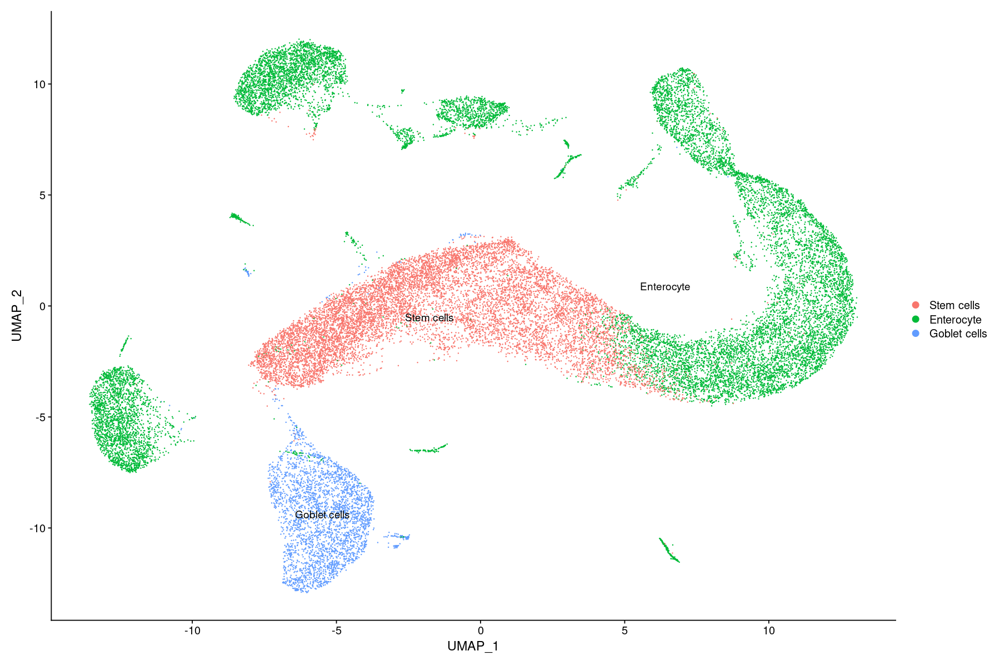

In [171]:
options(repr.plot.height = 10, repr.plot.width = 15)
DimPlot(ileum, reduction = "umap", label = TRUE)

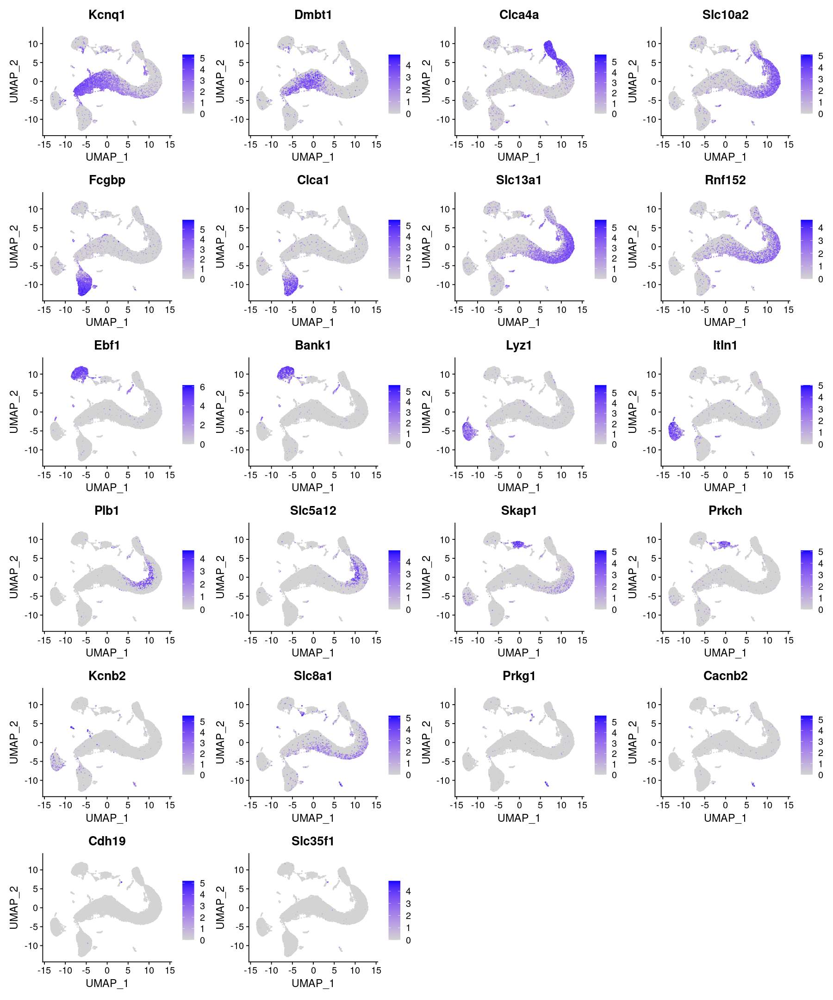

In [134]:
# looking top two DEGs per cluster 
options(repr.plot.height = 18, repr.plot.width = 15)
FeaturePlot(ileum, reduction = "umap", features = best.wilcox.gene.per.cluster)

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Defa6, Ta, Mk167, Best4, Ca7, Ca2”


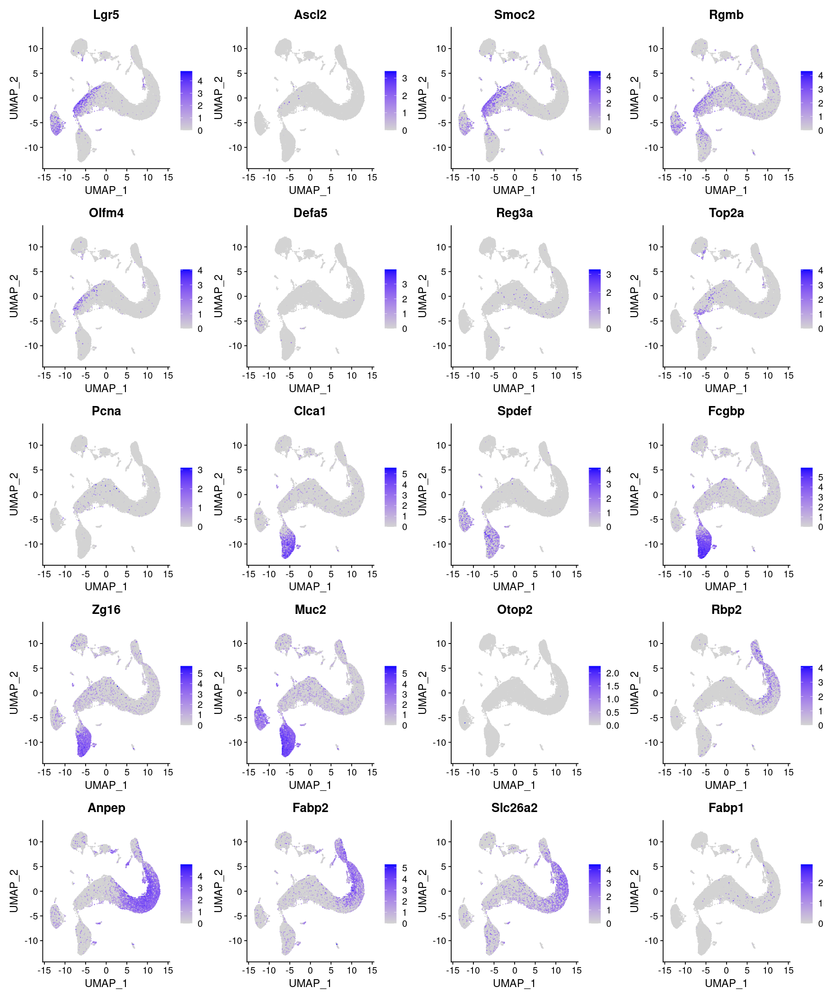

In [138]:
# PART 1 of 2
# (source) from Nature paper "Cells of the human intestinal tract mapped across space and time"
#  - (link) https://www.nature.com/articles/s41586-021-03852-1#Sec8
options(repr.plot.height = 18, repr.plot.width = 15)
FeaturePlot(ileum, reduction = "umap",
                    features = c(
                                "Lgr5", "Ascl2", "Smoc2", "Rgmb", "Olfm4",    # Stem cells
                                "Defa5", "Defa6", "Reg3a",                    # Paneth
                                "Ta", "Mk167", "Top2a", "Pcna",               # Transit-amplifying
                                "Clca1", "Spdef", "Fcgbp", "Zg16", "Muc2",    # Goblet
                                "Best4", "Otop2", "Ca7",                       # BEST4 enterocyte
                                "Rbp2", "Anpep", "Fabp2",                     # enterocytes
                                "Ca2", "Slc26a2", "Fabp1"                    # colonocytes
                             ))

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Neurod1, Irag2, Klk15, Klk3, Mln, Ins, Npw”


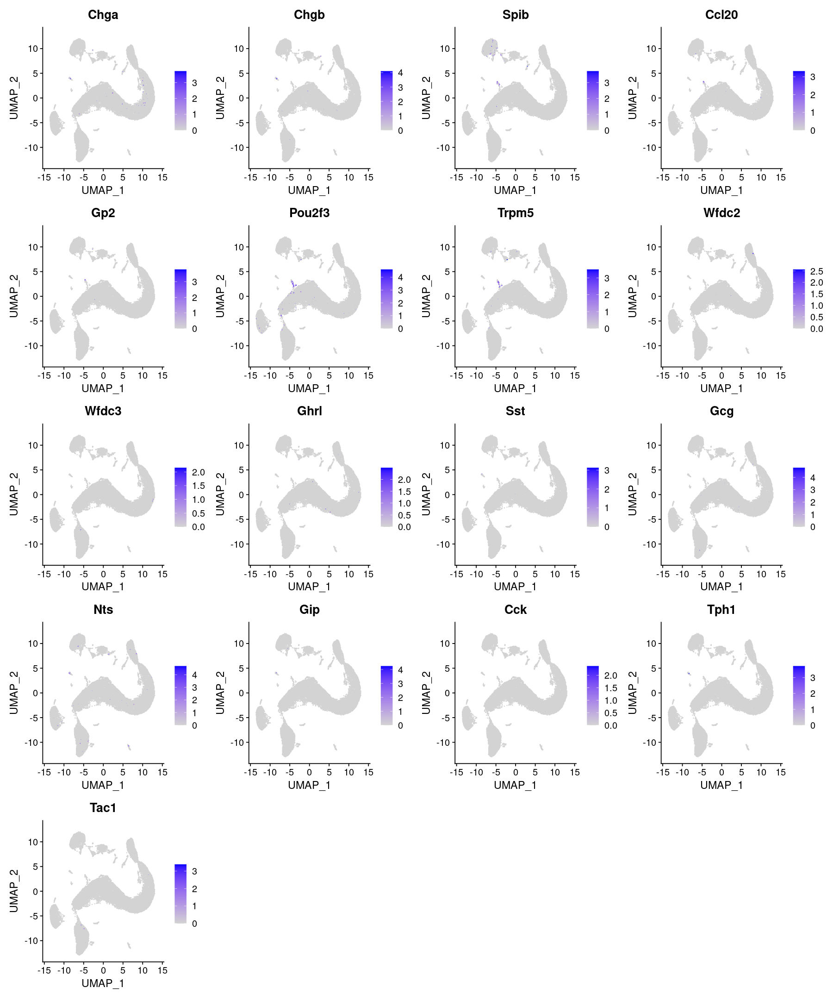

In [139]:
# PART 2 of 2
# (source) from Nature paper "Cells of the human intestinal tract mapped across space and time"
#  - (link) https://www.nature.com/articles/s41586-021-03852-1#Sec8
options(repr.plot.height = 18, repr.plot.width = 15)
FeaturePlot(ileum, reduction = "umap",
                    features = c(
                                "Chga", "Chgb", "Neurod1",                    # enteroendocrine
                                "Spib", "Ccl20", "Gp2",                       # Microfold cells
                                "Pou2f3", "Irag2", "Trpm5",                   # Tuft cells
                                "Klk15", "Klk3", "Wfdc2", "Wfdc3",            # BEST2 goblet cells
                        
                                "Mln", "Ghrl", "Sst", "Ins", "Gcg", "Nts",    # enteroendocrine cells
                                "Gip", "Cck", "Tph1", "Npw", "Tac1"           # enteroendocrine cells
                        
                             ))

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Hba, Mt, Hmgb”


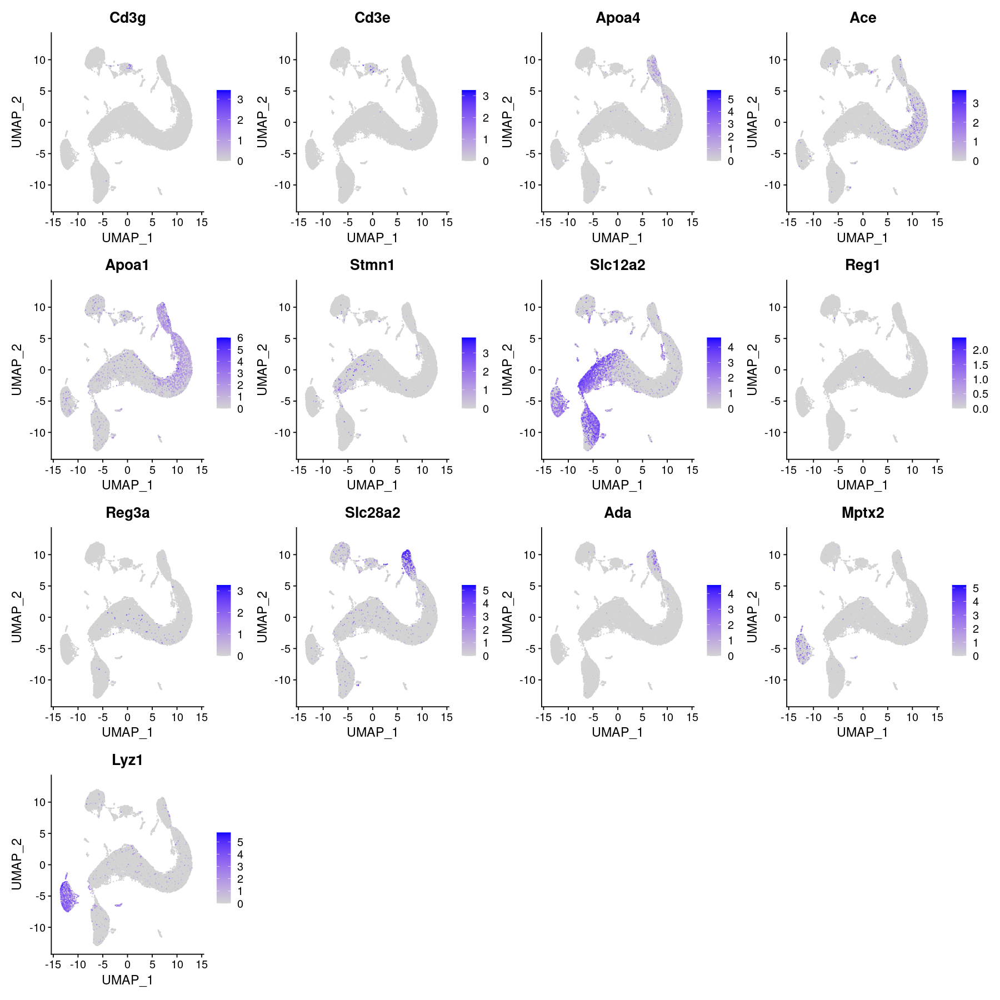

In [143]:
# PART 1 of 2
# (source) from 10X tutorial on intestinal data
#  - (linke) https://support.10xgenomics.com/img/single-cell-gex/gex-analysis-tour-4.png
options(repr.plot.height = 15, repr.plot.width = 15)
FeaturePlot(ileum, reduction = "umap",
                    features = c(
                                "Hba",                       # Erythrocytes/ Dying cells
                                # "Mt genes",                  # Dying cells 
                                "Cd3g", "Cd3e",              # Immune cells
                                "Apoa4", "Mt",               # Enterocytes/ Dying cells
                                "Ace","Apoa1",               # Enterocytes
                                "Stmn1", "Hmgb", "Slc12a2",  # CBCs (crypt base columnar cells)
                                "Reg1","Reg3a",              # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                "Mptx2", "Lyz1"             # Paneth cell  
                                # "Mt genes",                  # Dying cells
                          
                             ))

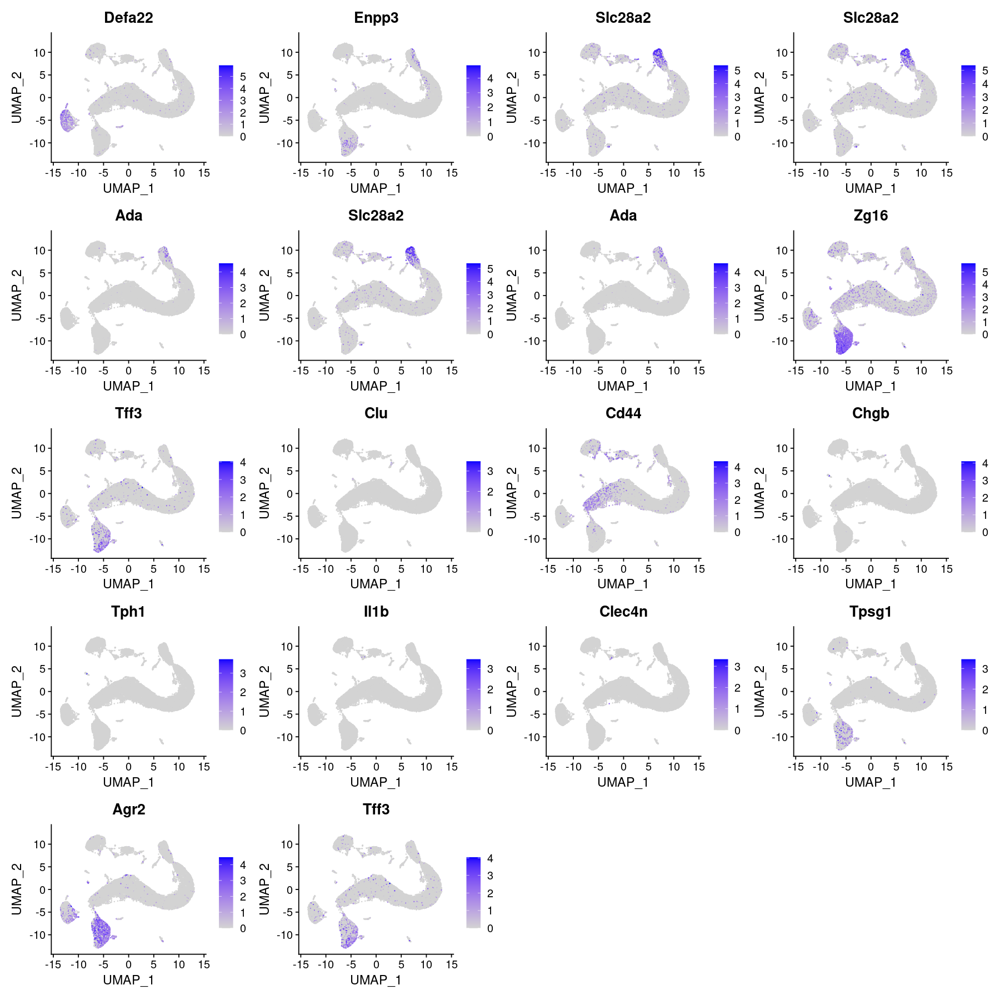

In [140]:
# PART 2 of 2
# (source) from 10X tutorial on intestinal data
#  - (linke) https://support.10xgenomics.com/img/single-cell-gex/gex-analysis-tour-4.png
options(repr.plot.height = 15, repr.plot.width = 15)
FeaturePlot(ileum, reduction = "umap",
                    features = c(
                                "Defa22",                    # Paneth cell  
                                "Enpp3","Slc28a2",           # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                # "Mt genes",                  # Dying cells
                                "Zg16","Tff3",               # Goblet cells
                                "Clu", "Cd44",               # ?
                                "Chgb", "Tph1",              # Enteroendocrine cells
                                "Il1b", "Clec4n",            # Immune cells
                                "Tpsg1","Agr2","Tff3"        # Goblet cells
                             ))

#### TSNE plot with DGE genes, Nature paper marker genes, and tutorial genes overlayed

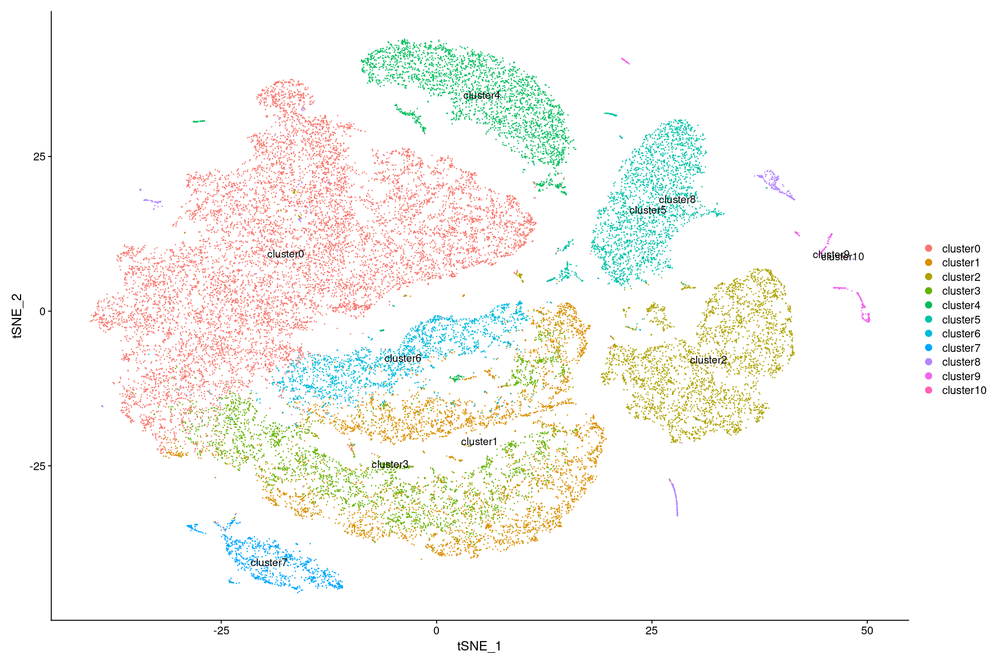

In [142]:
options(repr.plot.height = 10, repr.plot.width = 15)
DimPlot(ileum, reduction = "tsne", label = TRUE)

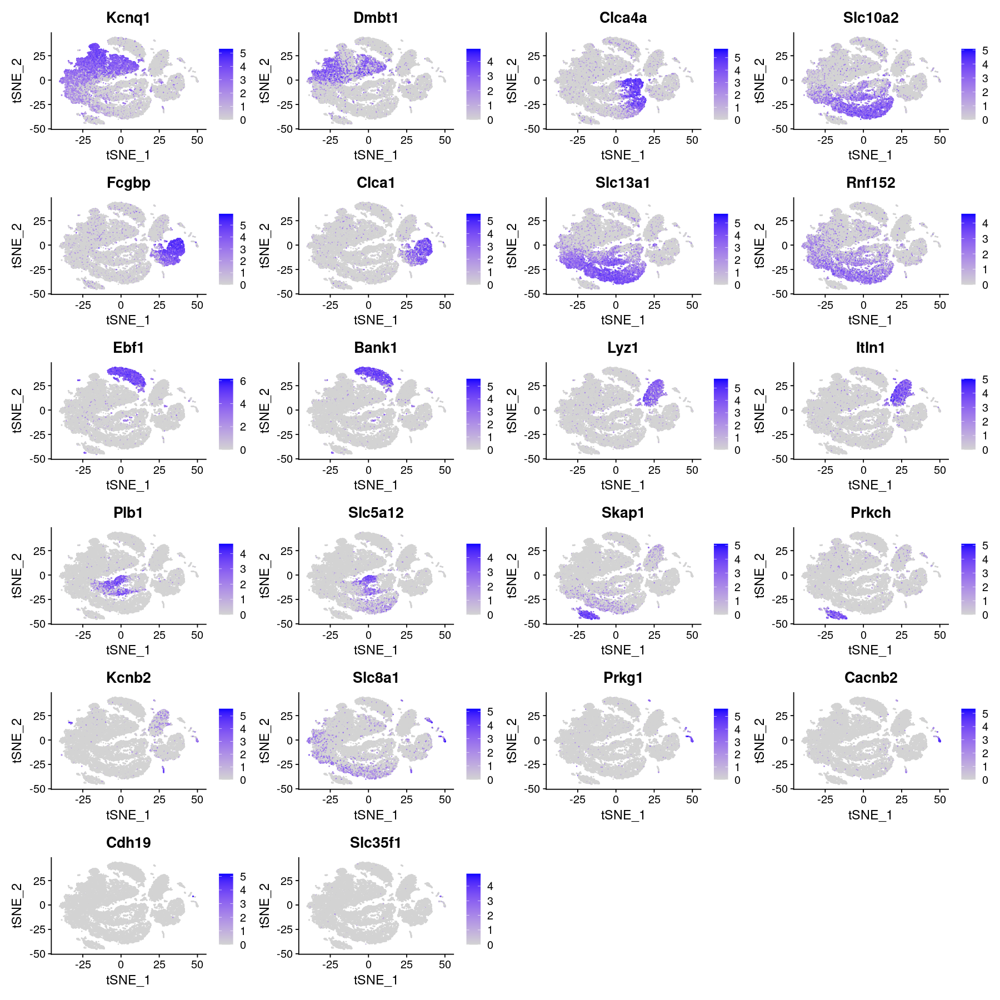

In [121]:
# looking top two DEGs per cluster 
options(repr.plot.height = 15, repr.plot.width = 15)
FeaturePlot(ileum, reduction = "tsne", features = best.wilcox.gene.per.cluster)

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Defa6, Ta, Mk167, Best4, Ca7, Ca2”


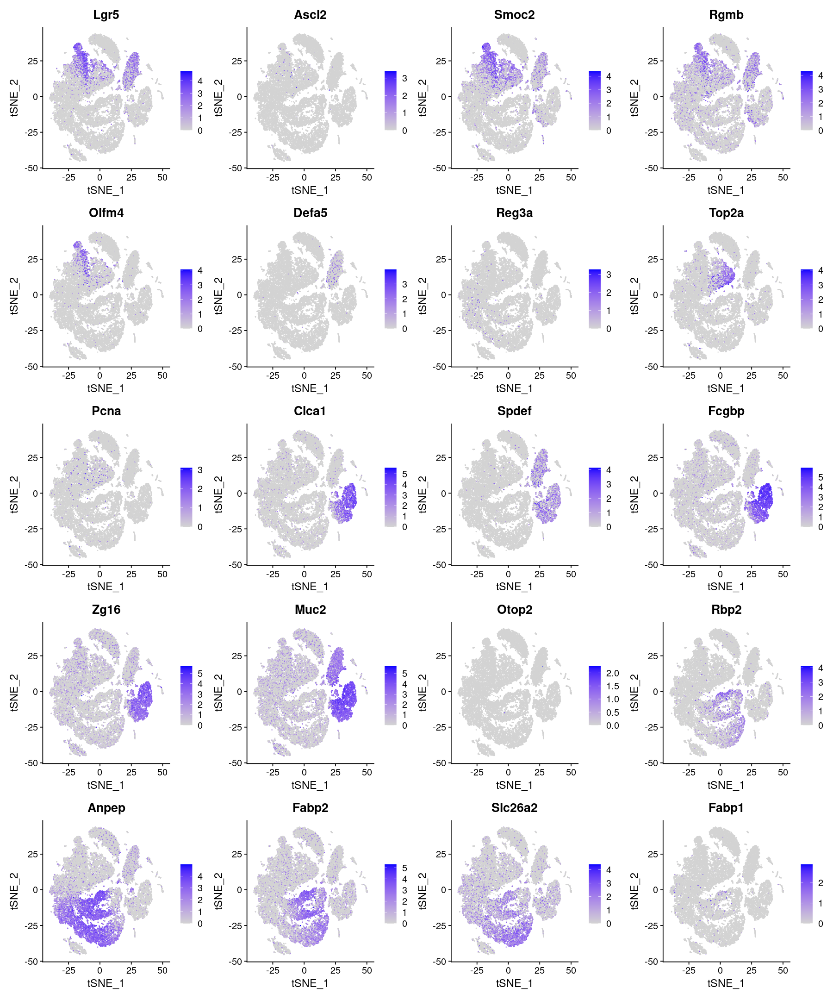

In [144]:
# PART 1 of 2
# (source) from Nature paper "Cells of the human intestinal tract mapped across space and time"
#  - (link) https://www.nature.com/articles/s41586-021-03852-1#Sec8
options(repr.plot.height = 18, repr.plot.width = 15)
FeaturePlot(ileum, reduction = "tsne",
                    features = c(
                                "Lgr5", "Ascl2", "Smoc2", "Rgmb", "Olfm4",    # Stem cells
                                "Defa5", "Defa6", "Reg3a",                    # Paneth
                                "Ta", "Mk167", "Top2a", "Pcna",               # Transit-amplifying
                                "Clca1", "Spdef", "Fcgbp", "Zg16", "Muc2",    # Goblet
                                "Best4", "Otop2", "Ca7",                       # BEST4 enterocyte
                                "Rbp2", "Anpep", "Fabp2",                     # enterocytes
                                "Ca2", "Slc26a2", "Fabp1"                    # colonocytes
                               
                             ))

In [ ]:
# PART 2 of 2
# (source) from Nature paper "Cells of the human intestinal tract mapped across space and time"
#  - (link) https://www.nature.com/articles/s41586-021-03852-1#Sec8
options(repr.plot.height = 18, repr.plot.width = 15)
FeaturePlot(ileum, reduction = "tsne",
                    features = c(
                                "Chga", "Chgb", "Neurod1",                    # enteroendocrine
                                "Spib", "Ccl20", "Gp2",                       # Microfold cells
                                "Pou2f3", "Irag2", "Trpm5",                   # Tuft cells
                                "Klk15", "Klk3", "Wfdc2", "Wfdc3",            # BEST2 goblet cells
                        
                                "Mln", "Ghrl", "Sst", "Ins", "Gcg", "Nts",    # enteroendocrine cells
                                "Gip", "Cck", "Tph1", "Npw", "Tac1"           # enteroendocrine cells
                        
                             ))

In [ ]:
# PART 1 of 2
# (source) from 10X tutorial on intestinal data
#  - (linke) https://support.10xgenomics.com/img/single-cell-gex/gex-analysis-tour-4.png
options(repr.plot.height = 15, repr.plot.width = 15)
FeaturePlot(ileum, reduction = "tsne",
                    features = c(
                                "Hba",                       # Erythrocytes/ Dying cells
                                # "Mt genes",                  # Dying cells 
                                "Cd3g", "Cd3e",              # Immune cells
                                "Apoa4", "Mt",               # Enterocytes/ Dying cells
                                "Ace","Apoa1",               # Enterocytes
                                "Stmn1", "Hmgb", "Slc12a2",  # CBCs (crypt base columnar cells)
                                "Reg1","Reg3a",              # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                "Mptx2", "Lyz1"             # Paneth cell  
                                # "Mt genes",                  # Dying cells
                          
                             ))

In [ ]:
# PART 2 of 2
# (source) from 10X tutorial on intestinal data
#  - (linke) https://support.10xgenomics.com/img/single-cell-gex/gex-analysis-tour-4.png
options(repr.plot.height = 15, repr.plot.width = 15)
FeaturePlot(ileum, reduction = "tsne",
                    features = c(
                                "Defa22",                    # Paneth cell  
                                "Enpp3","Slc28a2",           # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                "Slc28a2","Ada",             # Enterocytes
                                # "Mt genes",                  # Dying cells
                                "Zg16","Tff3",               # Goblet cells
                                "Clu", "Cd44",               # ?
                                "Chgb", "Tph1",              # Enteroendocrine cells
                                "Il1b", "Clec4n",            # Immune cells
                                "Tpsg1","Agr2","Tff3"        # Goblet cells
                             ))

#### Other Seurat visuals

In [ ]:
# In this case, we are plotting the top 20 markers (or all markers if less than 20) for each cluster.
ileum.markers %>%
    group_by(cluster) %>%
    top_n(n = 10, wt = avg_log2FC) -> top10
DoHeatmap(ileum, features = top10$gene) + NoLegend()


## Assigning cell type identity to clusters

#### For case of ileum dataset, we can try cell markers to match the unbiased clusters to known cell types

  
| Cluster ID  | Markers       | Cell Type      | Associated Study |
| ----------- | ------------- | -------------- | ---------------- |
| 0           | Smoc2         | Stem cell      | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7471277/ |
| 0           | Lgr5          | Stem cell      | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7332981/ |
| 1           | Fabp2         | Enterocyte     | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4323920/ |
| 2           | Tff3          | Goblet cell    | https://www.nature.com/articles/s41419-022-04504-6 |
| 2           | Agr2          | Goblet cell    | https://www.sciencedirect.com/science/article/pii/S0012160609013979 |
| 3           | Fabp2         | Enterocyte     | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4323920/ |
| 4           | Bank1         | B cell         | https://www.mdpi.com/2073-4409/10/5/1184 |
| 4           | Ebf1          | B cell         | https://www.ncbi.nlm.nih.gov/gene?Db=gene&Cmd=DetailsSearch&Term=13591 |
| 5           | Lyz1          | Paneth cell    | https://www.sciencedirect.com/science/article/pii/S1074761320303174 |
| 5           | Mptx2         | Paneth cell    | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC8687451/ |
| 5           | Itln1         | Paneth cell    | https://www.nature.com/articles/s41598-021-94679-3 |
| 6           | Fabp2         | Enterocyte     | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4323920/ |
| 6           | Ada           | Enterocyte     | https://www.embopress.org/doi/full/10.15252/embr.202256454 |
| 6           | Slc28a2       | Enterocyte     | https://www.cell.com/cell/pdf/S0092-8674(18)31164-4.pdf |
| 7           | Skap1         | T cell         | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC10380396/ | 
| 7           | Prkch         | T cell         | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3242502/ | 
| 8           | Pou2f3        | Tuft cell      | https://www.ncbi.nlm.nih.gov/pmc/articles/PMC9419707/ |
| 8           | Trpm5         | Tuft cell      | https://onlinelibrary.wiley.com/doi/10.1002/cne.21768 |
| 9           | Prkg1         | Smooth muscle? | https://academic.oup.com/cardiovascres/article/97/2/200/334119 |
| 10          | Cdh19         | Neuron?        | https://www.gastrojournal.org/article/S0016-5085(21)03409-0/pdf |

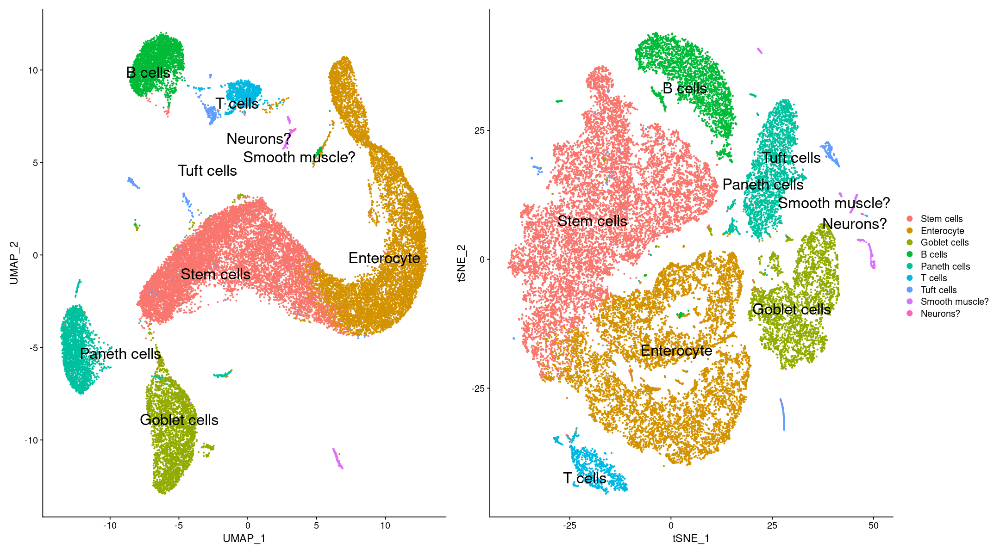

In [184]:
# create a plot that has cluster names included
options(repr.plot.height = 10, repr.plot.width = 18)
new.cluster.ids <- c(
                    "Stem cells",      # cluster0
                    "Enterocyte",      # cluster1
                    "Goblet cells",    # cluster2
                    "Enterocyte",      # cluster3
                    "B cells",         # cluster4
                    "Paneth cells",    # cluster5
                    "Enterocyte",      # cluster6
                    "T cells",         # cluster7
                    "Tuft cells",      # cluster8
                    "Smooth muscle?",  # cluster9
                    "Neurons?"         # cluster10
                )
names(new.cluster.ids) <- levels(ileum)
ileum_labeled <- RenameIdents(ileum, new.cluster.ids)
umap_labeled <- DimPlot(ileum_labeled, reduction = "umap", label = TRUE, pt.size = 0.5, label.size = 7, repel=TRUE) + NoLegend()
tsne_labeled <- DimPlot(ileum_labeled, reduction = "tsne", label = TRUE, pt.size = 0.5, label.size = 7, repel=TRUE) 
umap_labeled + tsne_labeled

In [185]:
my_marker_genes = c(
                    "Smoc2",
                    "Lgr5",
                    "Fabp2",
                    "Tff3",
                    "Agr2",
                    "Fabp2",
                    "Bank1",
                    "Ebf1",
                    "Lyz1",
                    "Mptx2",
                    "Itln1",
                    "Fabp2",
                    "Ada",
                    "Slc28a2",
                    "Skap1",
                    "Prkch",
                    "Pou2f3",
                    "Trpm5",
                    "Prkg1",
                    "Cdh19"
                    )

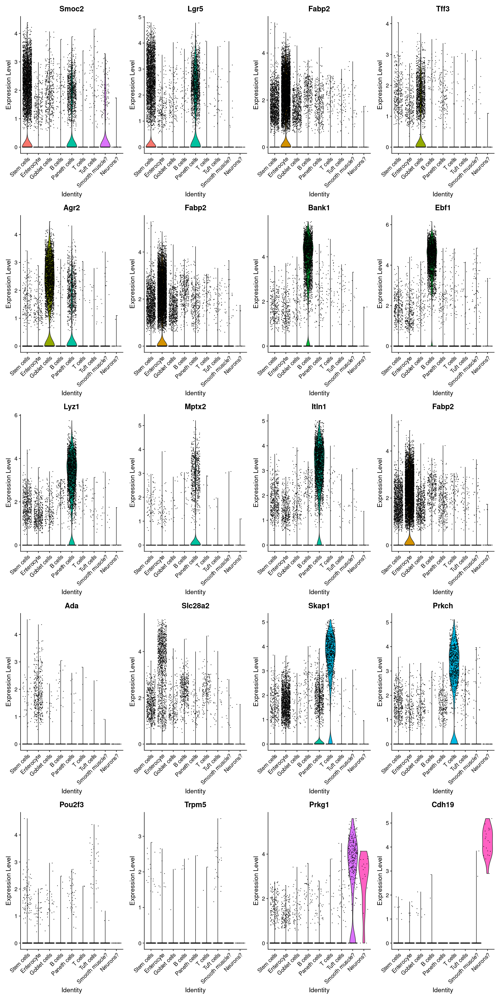

In [186]:
options(repr.plot.height = 30, repr.plot.width = 15)
VlnPlot(ileum_labeled,features=my_marker_genes)

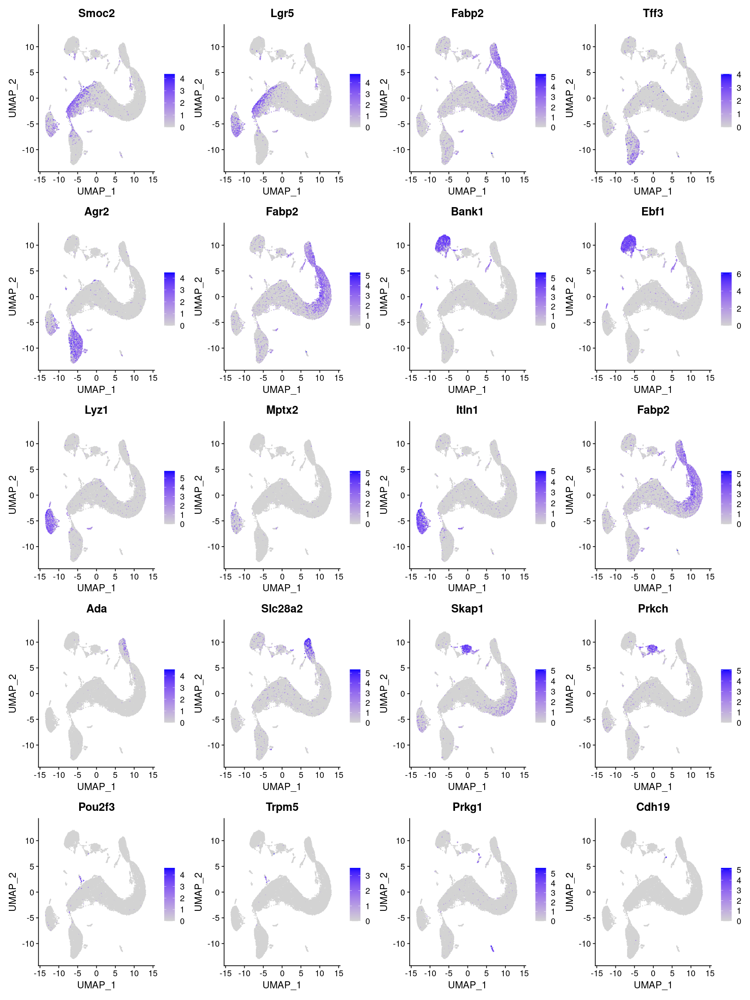

In [189]:
# looking top two DEGs per cluster 
options(repr.plot.height = 20, repr.plot.width = 15)
FeaturePlot(ileum, reduction = "umap", features = my_marker_genes)

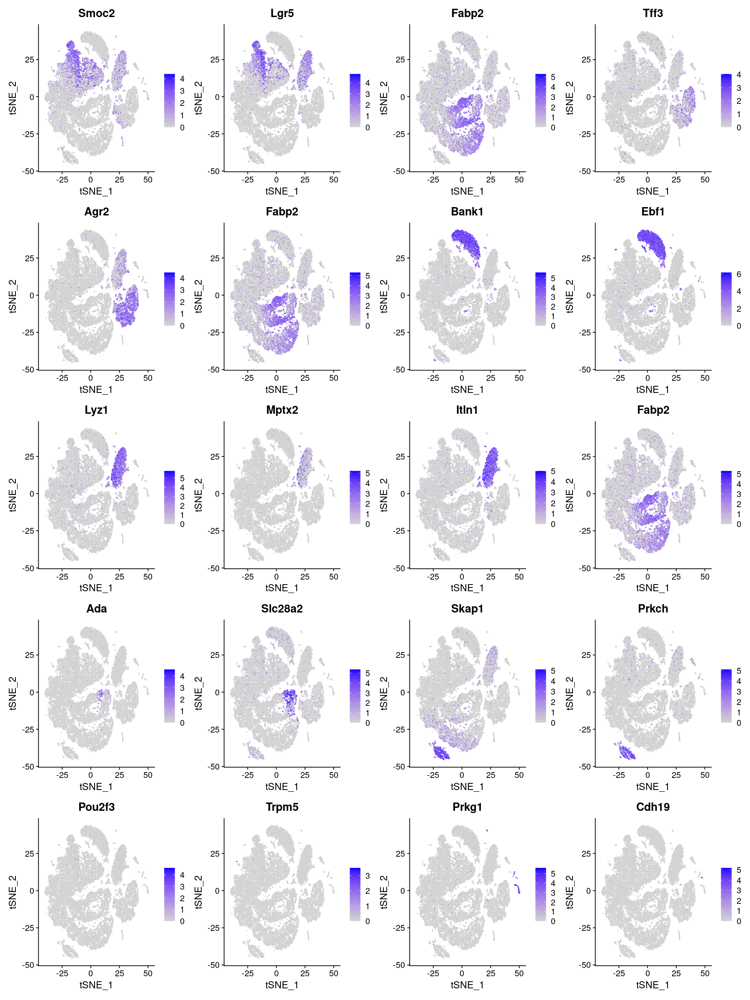

In [190]:
# looking top two DEGs per cluster 
options(repr.plot.height = 20, repr.plot.width = 15)
FeaturePlot(ileum, reduction = "tsne", features = my_marker_genes)

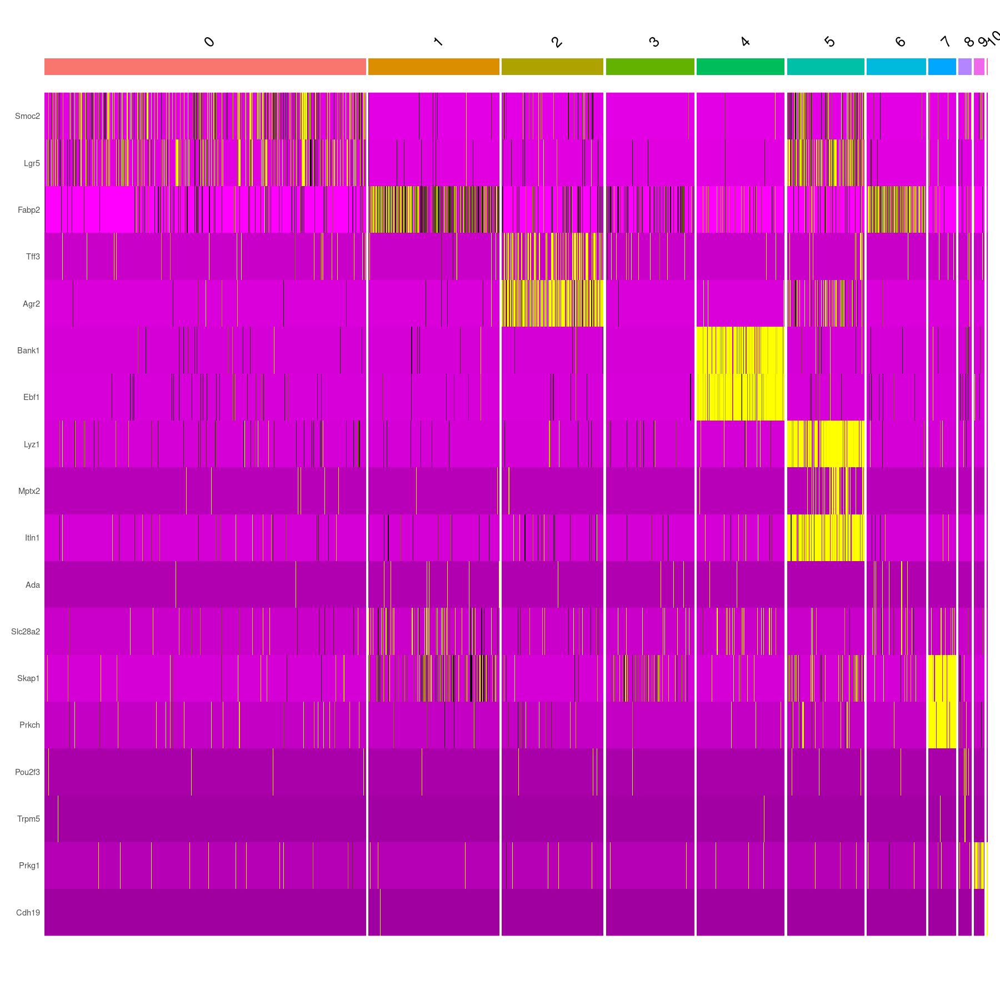

In [191]:
options(repr.plot.height = 15, repr.plot.width = 15)
DoHeatmap(ileum, features = my_marker_genes) + NoLegend()


In [168]:
## save
# saveRDS(pbmc, file = "results/pbmc3k_final.rds")